[View in Colaboratory](https://colab.research.google.com/github/dkatsios/Yes_we_GAN/blob/master/Flags_std_DCGAN.ipynb)

# Flags std DCGAN

### Imports

In [1]:
from keras.models import Model
from keras.layers import Input, Dense, BatchNormalization, Reshape, Flatten
from keras.layers import UpSampling2D, Conv2D, Concatenate
from keras.layers.advanced_activations import LeakyReLU
from keras.initializers import RandomNormal
from keras.datasets import fashion_mnist
from keras.optimizers import Adam

import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Image

Using TensorFlow backend.


In [0]:
%%capture
%cd /content
%rm -r /content/Yes_we_GAN
!git clone https://github.com/dkatsios/Yes_we_GAN.git
flags_dir = '/content/Yes_we_GAN/flags/32x32/'

In [0]:

def flags_loader(flags_dir, img_shape, batch_size):
  from glob import glob
  from itertools import cycle
  flags_list = glob(flags_dir + '*.*')
  flags_list = cycle(flags_list)
  while True:
    imgs = np.zeros((batch_size, *img_shape))
    for i in range(batch_size):
      flag = next(flags_list)
      flag = plt.imread(flag)
      flag = flag * 2 - 1
      imgs[i] = flag
    
    yield imgs

### Function to build the generator

In [0]:
def build_generator(noise_size, img_shape):
  
  filters = 512
  k_size = 5, 5
  k_init = RandomNormal(0, 0.02)
  
  noise = Input((noise_size,))
  
  x = Dense(4*4*filters, activation='relu', kernel_initializer=k_init)(noise)
  x = Reshape((4, 4, filters))(x)  # 4, 4
  x = BatchNormalization()(x)
  x = UpSampling2D()(x)  # 8, 8
  
  x = Conv2D(filters // 2, k_size, padding='same', activation='relu', kernel_initializer=k_init)(x)
  x = BatchNormalization()(x)
  x = UpSampling2D()(x)  # 16, 16
  
  x = Conv2D(filters // 4, k_size, padding='same', activation='relu', kernel_initializer=k_init)(x)
  x = BatchNormalization()(x)
  x = UpSampling2D()(x)  # 32, 32
  
  img = Conv2D(img_shape[-1], k_size, padding='same', activation='tanh', kernel_initializer=k_init)(x)
  
  generator = Model(noise, img)
  return generator

### Function to build the discriminator

In [0]:
def build_discriminator(img_shape):
  
  filters = 512
  k_size = 5, 5
  k_init = RandomNormal(0, 0.02)
  
  img = Input(img_shape)  # 32, 32
  std = Input((1,))
  
  x = Conv2D(filters // 4, k_size, strides=(2, 2), padding='same', kernel_initializer=k_init)(img)
  x = BatchNormalization()(x)
  x = LeakyReLU(0.2)(x)  # 16, 16
  
  x = Conv2D(filters // 2, k_size, strides=(2, 2), padding='same', kernel_initializer=k_init)(img)
  x = BatchNormalization()(x)
  x = LeakyReLU(0.2)(x)  # 8, 8
  
  x = Conv2D(filters, k_size, strides=(2, 2), padding='same', kernel_initializer=k_init)(img)
  x = BatchNormalization()(x)
  x = LeakyReLU(0.2)(x)  # 4, 4
  
  x = Flatten()(x)
  x = Concatenate()([x, std])
  validity = Dense(1, activation='sigmoid')(x)
  
  discriminator = Model([img, std], validity)
  return discriminator

### Function to compile the models

In [0]:
def get_compiled_models(generator, discriminator, noise_size):
  
  optimizer = Adam(0.0002, 0.5)
  
  discriminator.compile(optimizer, loss='binary_crossentropy', metrics=['accuracy'])
  discriminator.trainable = False
  
  noise = Input((noise_size,))
  std = Input((1,))
  
  img = generator(noise)
  validity = discriminator([img, std])
  combined = Model([noise, std], validity)
  
  combined.compile(optimizer, loss='binary_crossentropy')
  
  return generator, discriminator, combined

### Function to sample and save generated images

In [0]:
def sample_imgs(generator, noise_size, step, plot_img=True, cond=False, num_classes=10, gray=True):
  np.random.seed(0)
  
  r, c = num_classes, 10
  if cond:
    noise = np.random.normal(0, 1, (c, noise_size))
    noise = np.tile(noise, (r, 1))

    sampled_labels = np.arange(r).reshape(-1, 1)
    sampled_labels = to_categorical(sampled_labels, r)
    sampled_labels = np.repeat(sampled_labels, c, axis=0)

    imgs = generator.predict([noise, sampled_labels])
  else:
    noise = np.random.normal(0, 1, (r*c, noise_size))
    imgs = generator.predict_on_batch(noise)
  
  imgs = imgs / 2.0001 + 0.5
  imgs = np.reshape(imgs, [r, c, imgs.shape[1], imgs.shape[2], -1])
  
  figsize = 1 * c, 1 * r
  fig, axs = plt.subplots(r, c, figsize=figsize)
  
  for i in range(r):
    for j in range(c):
      if gray:
        img = imgs[i, j] if len(imgs.shape) == 4 else imgs[i, j, :, :, 0]
        axs[i, j].imshow(img, cmap='gray')
      else:
        axs[i, j].imshow(imgs[i, j])
      axs[i, j].axis('off')
  plt.subplots_adjust(wspace=0.1, hspace=0.1)
  fig.savefig(f'/content/images/{step}.png')
  if plot_img:
    plt.show()
  plt.close()
  
  np.random.seed(None)

### Function to train the models

In [0]:
def train(models, noise_size, img_shape, batch_size, steps):
  
  generator, discriminator, combined = models
  #get real data iterator
  flags_iter = flags_loader(flags_dir, img_shape, batch_size)
  
  for step in range(1, steps + 1):
    # train discriminator
    real_imgs = next(flags_iter)
    real_validity = np.ones(batch_size)
    real_std = np.std(real_imgs, axis=0)
    real_std = np.average(real_std)
    real_std = np.reshape(real_std, (1, 1))
    real_std = np.tile(real_std, (batch_size, 1))
    
    noise = np.random.normal(0, 1, (batch_size, noise_size))
    gen_imgs = generator.predict(noise)
    gen_validity = np.zeros(batch_size)
    gen_std = np.std(gen_imgs, axis=0)
    gen_std = np.average(gen_std)
    gen_std = np.reshape(gen_std, (1, 1))
    gen_std = np.tile(gen_std, (batch_size, 1))
    
    r_loss = discriminator.train_on_batch([real_imgs, real_std], real_validity)
    g_loss = discriminator.train_on_batch([gen_imgs, gen_std], gen_validity)
    disc_loss = np.add(r_loss, g_loss) / 2
    
    # train generator
    noise = np.random.normal(0, 1, (batch_size, noise_size))
    gen_validity = np.ones(batch_size)
    gen_imgs = generator.predict(noise)
    gen_std = np.std(gen_imgs, axis=0)
    gen_std = np.average(gen_std)
    gen_std = np.reshape(gen_std, (1, 1))
    gen_std = np.tile(gen_std, (batch_size, 1))
    
    gen_loss = combined.train_on_batch([noise, gen_std], gen_validity)
    
    #print progress
    if step % 50 == 0:
      print('step: %d, D_loss: %f, D_accuracy: %.2f%%, G_loss: %f' % (step, disc_loss[0],
                                                                      disc_loss[1] * 100, gen_loss))
    
    # save_samples
    if step % 200 == 0:
      sample_imgs(generator, noise_size, step, gray=False)

### Define hyperparameters

In [9]:
%rm -r /content/images
%mkdir /content/images
noise_size = 100
img_shape = 32, 32, 4
batch_size = 64
steps = 10000

rm: cannot remove '/content/images': No such file or directory


### Generate the models

In [0]:
generator = build_generator(noise_size, img_shape)
discriminator = build_discriminator(img_shape)
compiled_models = get_compiled_models(generator, discriminator, noise_size)

### Train the models

/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:975: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


step: 50, D_loss: 0.048934, D_accuracy: 98.44%, G_loss: 16.118095
step: 100, D_loss: 0.000012, D_accuracy: 100.00%, G_loss: 16.118095
step: 150, D_loss: 0.000009, D_accuracy: 100.00%, G_loss: 16.118095
step: 200, D_loss: 0.000143, D_accuracy: 100.00%, G_loss: 16.118095


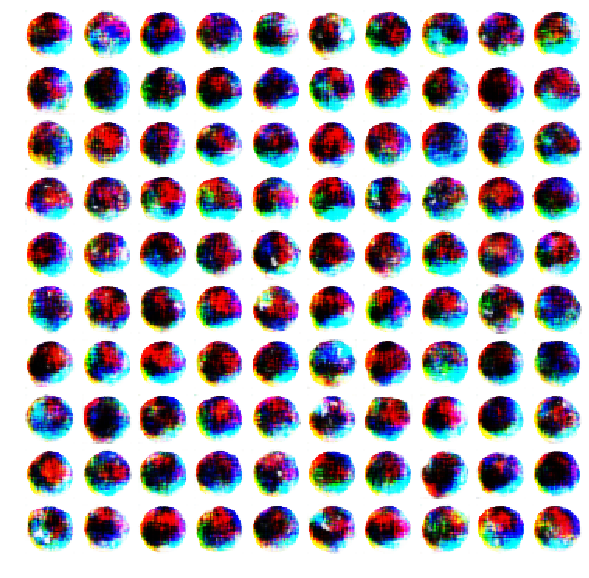

step: 250, D_loss: 0.000004, D_accuracy: 100.00%, G_loss: 16.118095
step: 300, D_loss: 1.121010, D_accuracy: 75.78%, G_loss: 14.887039
step: 350, D_loss: 1.359680, D_accuracy: 75.00%, G_loss: 2.081637
step: 400, D_loss: 3.808127, D_accuracy: 39.06%, G_loss: 13.175367


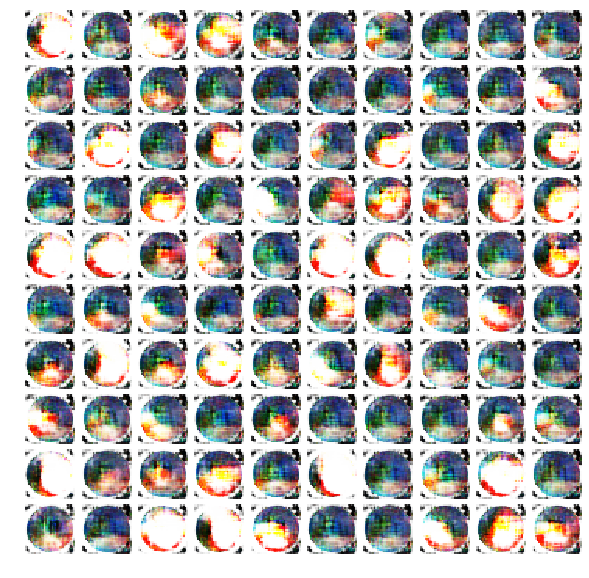

step: 450, D_loss: 1.770239, D_accuracy: 63.28%, G_loss: 10.573965
step: 500, D_loss: 3.403817, D_accuracy: 57.03%, G_loss: 14.419343
step: 550, D_loss: 1.564016, D_accuracy: 52.34%, G_loss: 9.205050
step: 600, D_loss: 1.518229, D_accuracy: 53.91%, G_loss: 15.681875


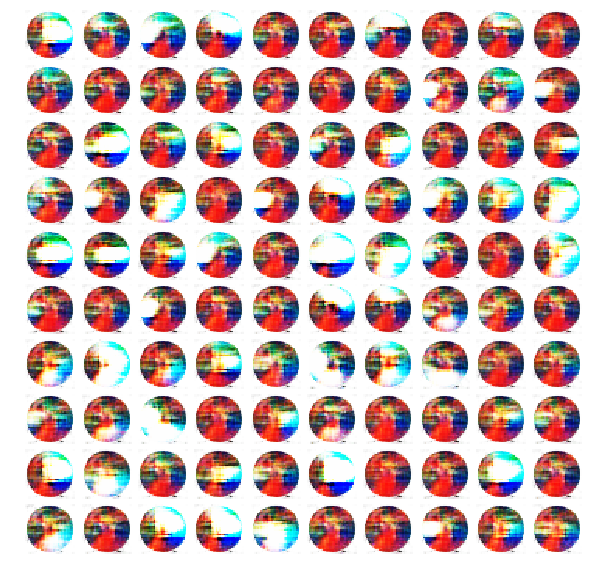

step: 650, D_loss: 1.416331, D_accuracy: 65.62%, G_loss: 5.932000
step: 700, D_loss: 0.135665, D_accuracy: 96.09%, G_loss: 6.278655
step: 750, D_loss: 1.090962, D_accuracy: 73.44%, G_loss: 4.882666
step: 800, D_loss: 0.419845, D_accuracy: 83.59%, G_loss: 5.797208


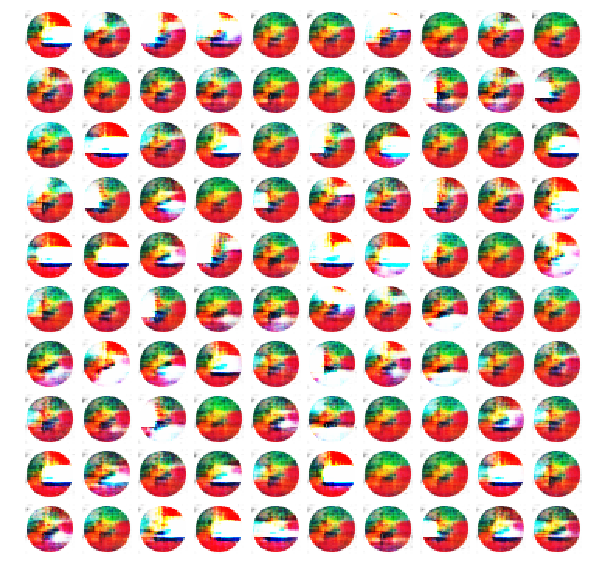

step: 850, D_loss: 0.186860, D_accuracy: 93.75%, G_loss: 5.283658
step: 900, D_loss: 0.528345, D_accuracy: 76.56%, G_loss: 8.396888
step: 950, D_loss: 0.127606, D_accuracy: 97.66%, G_loss: 4.079368
step: 1000, D_loss: 0.287720, D_accuracy: 90.62%, G_loss: 6.166343


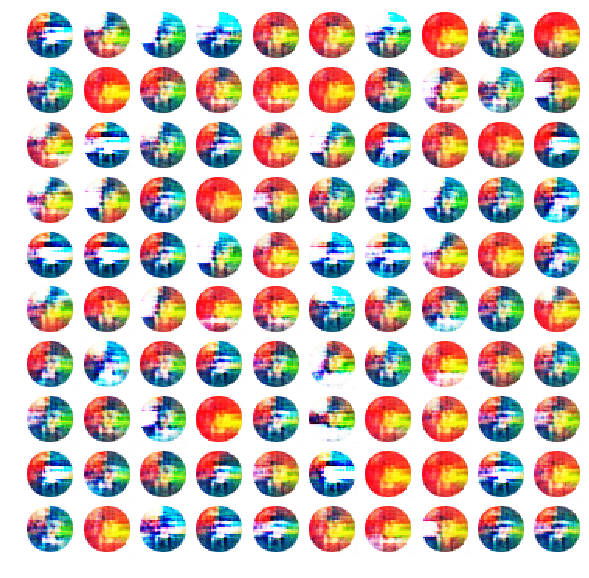

step: 1050, D_loss: 0.753930, D_accuracy: 75.00%, G_loss: 6.021440
step: 1100, D_loss: 0.350346, D_accuracy: 84.38%, G_loss: 6.366551
step: 1150, D_loss: 0.190608, D_accuracy: 94.53%, G_loss: 3.591966
step: 1200, D_loss: 0.062092, D_accuracy: 100.00%, G_loss: 4.136312


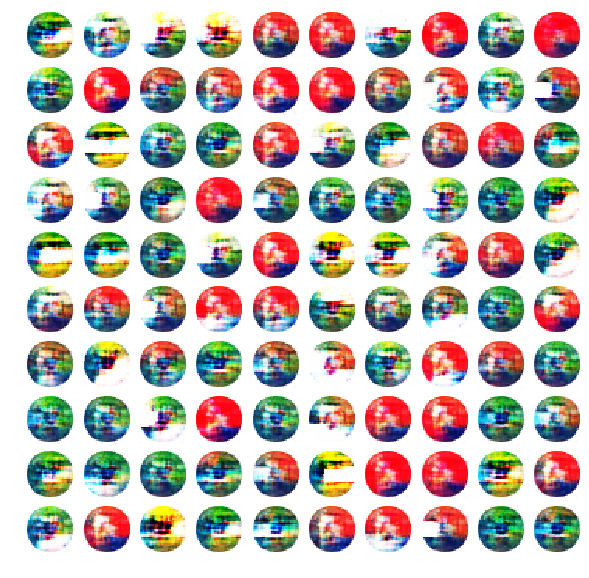

step: 1250, D_loss: 0.914070, D_accuracy: 65.62%, G_loss: 8.711534
step: 1300, D_loss: 0.532893, D_accuracy: 76.56%, G_loss: 5.888763
step: 1350, D_loss: 0.055412, D_accuracy: 98.44%, G_loss: 5.054056
step: 1400, D_loss: 0.126574, D_accuracy: 97.66%, G_loss: 4.179351


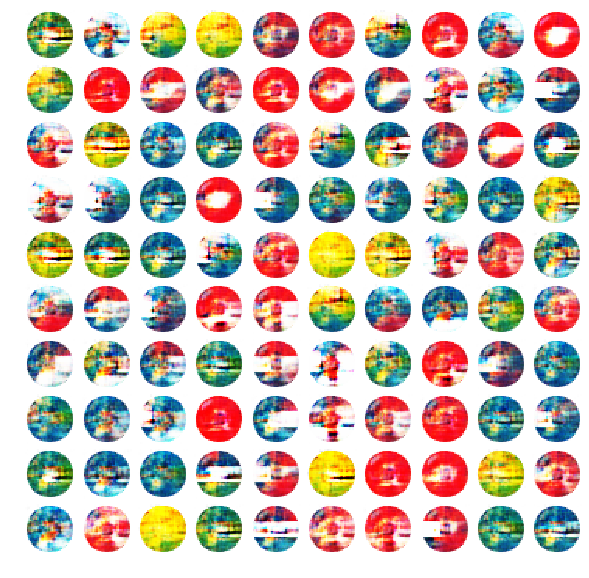

step: 1450, D_loss: 0.135776, D_accuracy: 97.66%, G_loss: 4.383853
step: 1500, D_loss: 0.080408, D_accuracy: 100.00%, G_loss: 4.132907
step: 1550, D_loss: 0.106527, D_accuracy: 95.31%, G_loss: 5.392828
step: 1600, D_loss: 0.047038, D_accuracy: 100.00%, G_loss: 2.900800


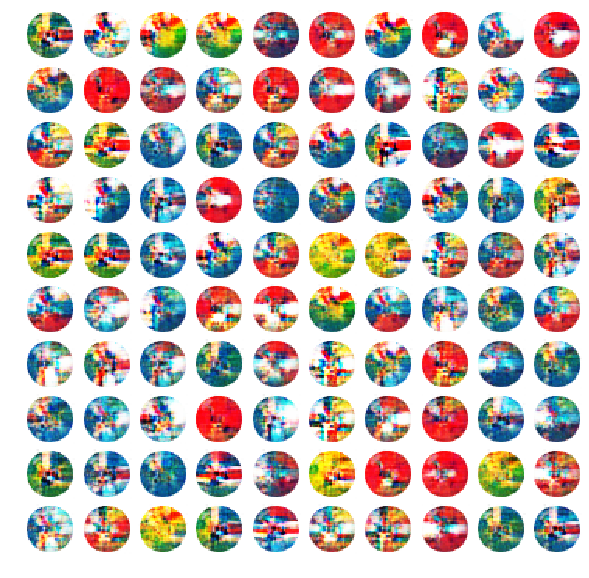

step: 1650, D_loss: 0.104414, D_accuracy: 97.66%, G_loss: 5.534467
step: 1700, D_loss: 0.098007, D_accuracy: 97.66%, G_loss: 4.684031
step: 1750, D_loss: 0.151284, D_accuracy: 93.75%, G_loss: 5.910377
step: 1800, D_loss: 0.273992, D_accuracy: 89.84%, G_loss: 4.325949


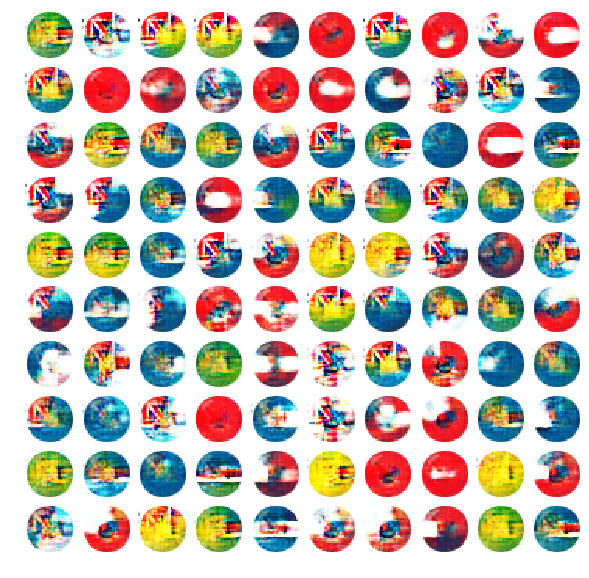

step: 1850, D_loss: 0.100533, D_accuracy: 98.44%, G_loss: 4.468200
step: 1900, D_loss: 0.118534, D_accuracy: 97.66%, G_loss: 3.218032
step: 1950, D_loss: 0.352326, D_accuracy: 80.47%, G_loss: 5.681531
step: 2000, D_loss: 0.154565, D_accuracy: 95.31%, G_loss: 4.346388


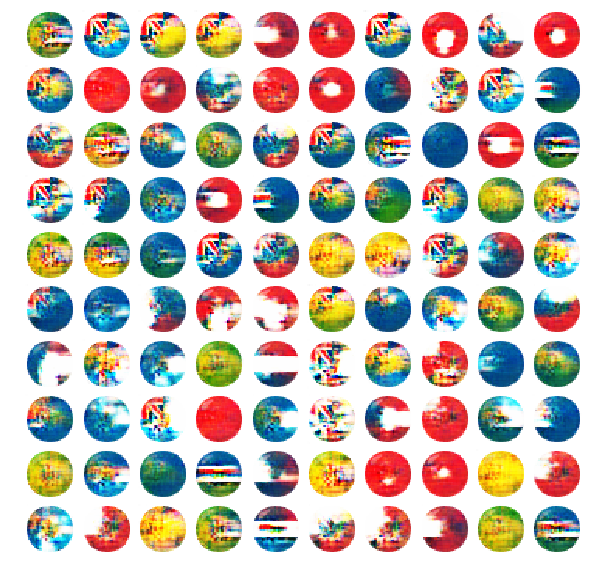

step: 2050, D_loss: 0.099473, D_accuracy: 96.88%, G_loss: 4.163276
step: 2100, D_loss: 0.035618, D_accuracy: 100.00%, G_loss: 6.486396
step: 2150, D_loss: 0.082629, D_accuracy: 98.44%, G_loss: 4.690770
step: 2200, D_loss: 0.110402, D_accuracy: 98.44%, G_loss: 3.719108


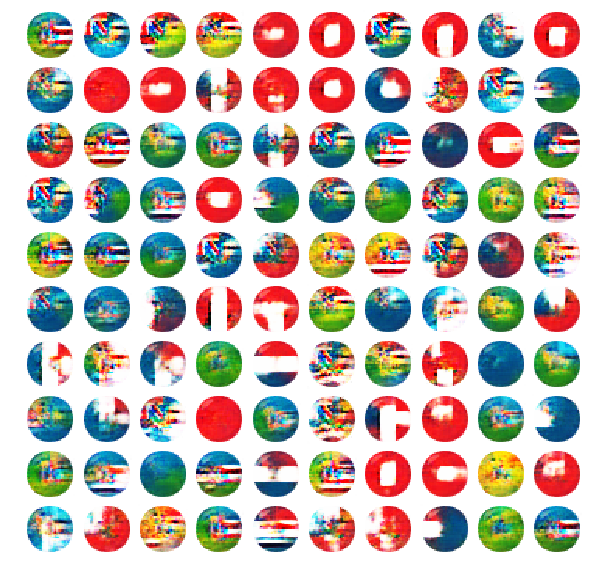

step: 2250, D_loss: 0.107556, D_accuracy: 96.88%, G_loss: 5.121119
step: 2300, D_loss: 0.135140, D_accuracy: 97.66%, G_loss: 4.198298
step: 2350, D_loss: 0.286625, D_accuracy: 87.50%, G_loss: 4.339454
step: 2400, D_loss: 0.658365, D_accuracy: 71.88%, G_loss: 6.472642


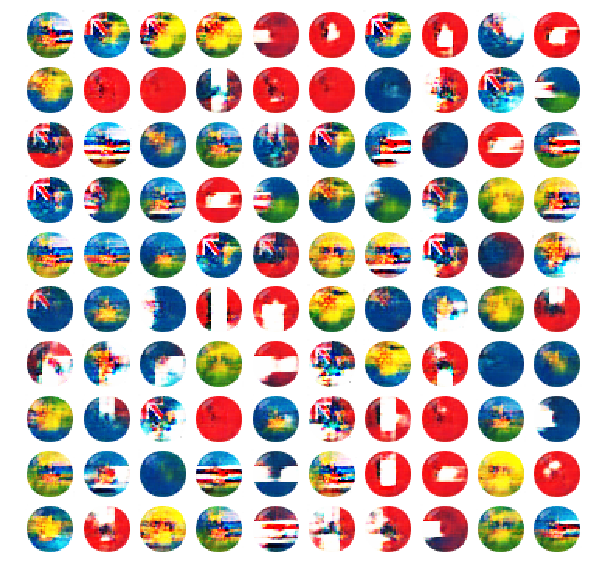

step: 2450, D_loss: 0.097154, D_accuracy: 99.22%, G_loss: 3.617102
step: 2500, D_loss: 0.313335, D_accuracy: 89.06%, G_loss: 5.169796
step: 2550, D_loss: 0.046566, D_accuracy: 99.22%, G_loss: 3.794436
step: 2600, D_loss: 0.131129, D_accuracy: 96.88%, G_loss: 5.288073


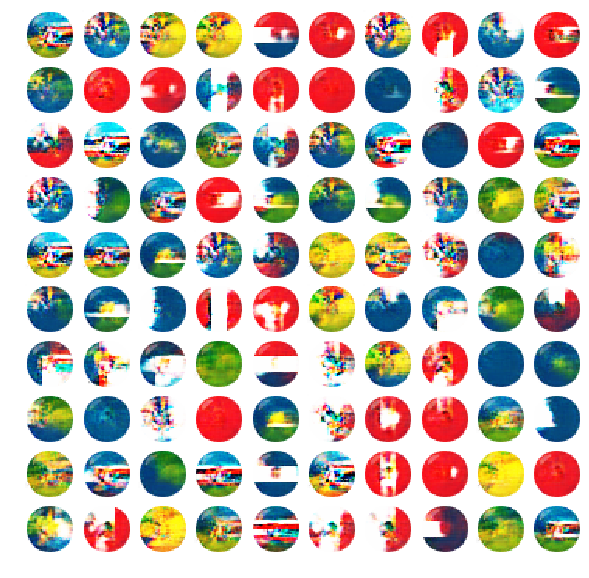

step: 2650, D_loss: 2.875081, D_accuracy: 26.56%, G_loss: 9.227529
step: 2700, D_loss: 0.088382, D_accuracy: 97.66%, G_loss: 4.146203
step: 2750, D_loss: 0.518546, D_accuracy: 74.22%, G_loss: 4.896582
step: 2800, D_loss: 0.109460, D_accuracy: 97.66%, G_loss: 4.523564


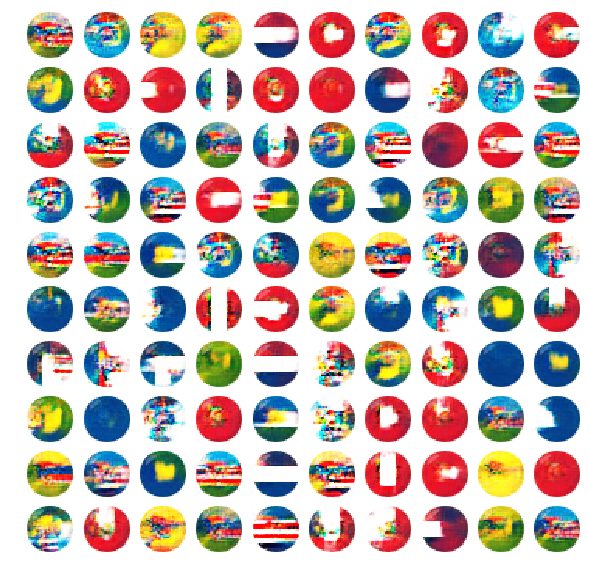

step: 2850, D_loss: 0.111504, D_accuracy: 96.88%, G_loss: 4.249446
step: 2900, D_loss: 0.918976, D_accuracy: 60.16%, G_loss: 4.928772
step: 2950, D_loss: 0.052953, D_accuracy: 100.00%, G_loss: 4.796254
step: 3000, D_loss: 0.256027, D_accuracy: 92.19%, G_loss: 5.561376


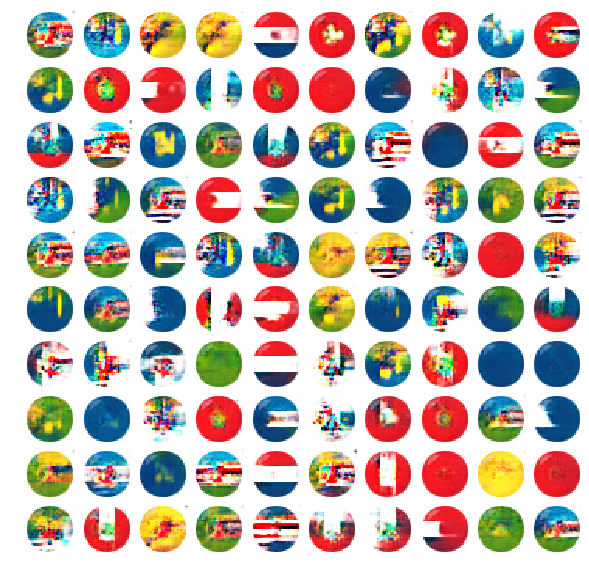

step: 3050, D_loss: 0.175784, D_accuracy: 93.75%, G_loss: 5.280182
step: 3100, D_loss: 0.025749, D_accuracy: 100.00%, G_loss: 4.401330
step: 3150, D_loss: 0.054817, D_accuracy: 100.00%, G_loss: 4.440848
step: 3200, D_loss: 0.176182, D_accuracy: 95.31%, G_loss: 4.322651


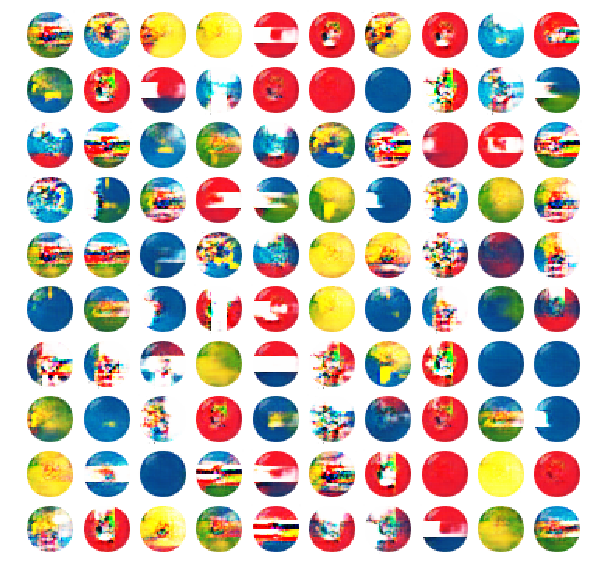

step: 3250, D_loss: 0.042208, D_accuracy: 100.00%, G_loss: 5.153613
step: 3300, D_loss: 0.087669, D_accuracy: 100.00%, G_loss: 5.360166
step: 3350, D_loss: 0.298393, D_accuracy: 87.50%, G_loss: 5.362629
step: 3400, D_loss: 0.074234, D_accuracy: 99.22%, G_loss: 4.483437


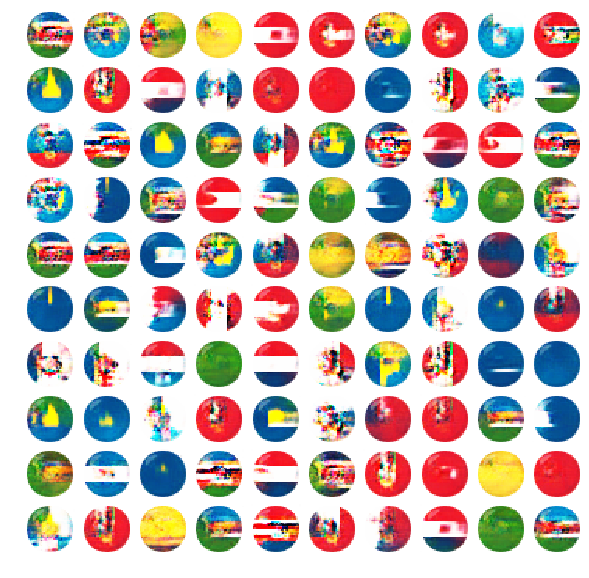

step: 3450, D_loss: 1.189932, D_accuracy: 51.56%, G_loss: 7.057150
step: 3500, D_loss: 0.066299, D_accuracy: 99.22%, G_loss: 4.365349
step: 3550, D_loss: 0.076939, D_accuracy: 99.22%, G_loss: 4.303446
step: 3600, D_loss: 0.254770, D_accuracy: 88.28%, G_loss: 4.946285


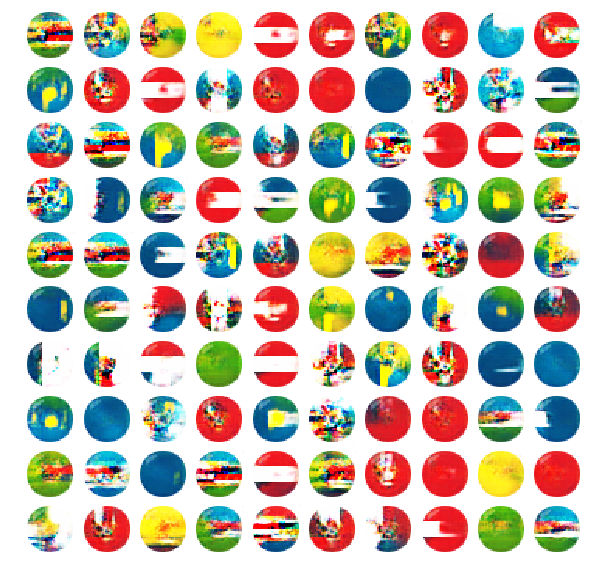

step: 3650, D_loss: 0.069287, D_accuracy: 100.00%, G_loss: 4.044943
step: 3700, D_loss: 0.094408, D_accuracy: 98.44%, G_loss: 4.778456
step: 3750, D_loss: 0.050624, D_accuracy: 100.00%, G_loss: 4.809630
step: 3800, D_loss: 0.261904, D_accuracy: 92.19%, G_loss: 5.290586


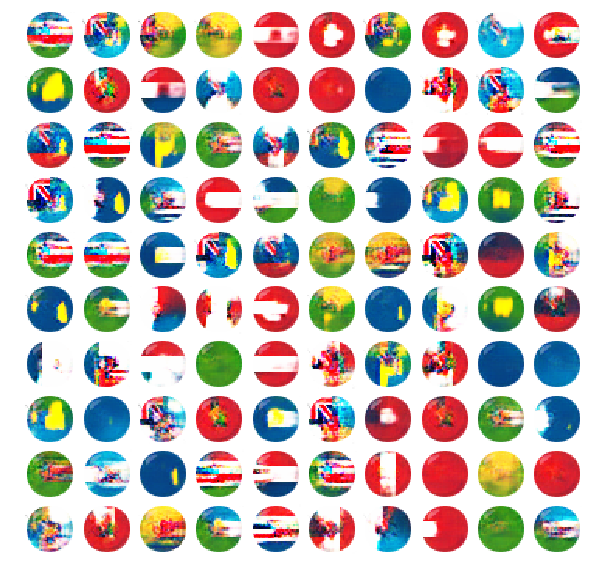

step: 3850, D_loss: 0.104969, D_accuracy: 96.88%, G_loss: 5.316119
step: 3900, D_loss: 0.150245, D_accuracy: 95.31%, G_loss: 5.018151
step: 3950, D_loss: 0.154104, D_accuracy: 92.97%, G_loss: 7.894296
step: 4000, D_loss: 0.071738, D_accuracy: 99.22%, G_loss: 3.152532


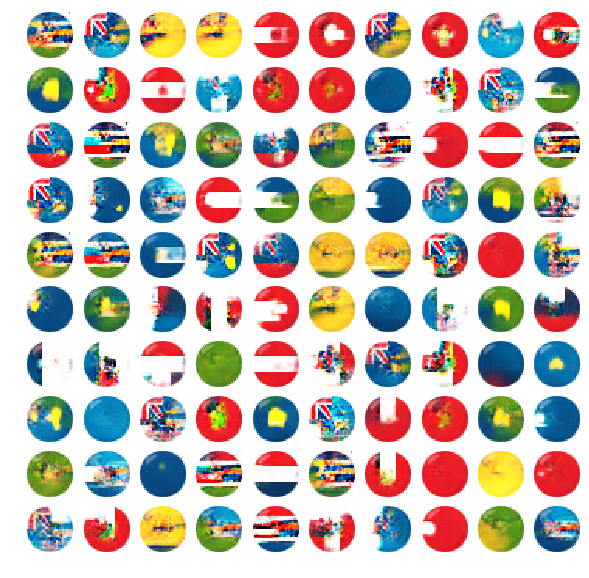

step: 4050, D_loss: 0.238822, D_accuracy: 91.41%, G_loss: 4.886569
step: 4100, D_loss: 0.048367, D_accuracy: 100.00%, G_loss: 4.711211
step: 4150, D_loss: 0.186676, D_accuracy: 89.84%, G_loss: 5.427792
step: 4200, D_loss: 0.082836, D_accuracy: 99.22%, G_loss: 4.760735


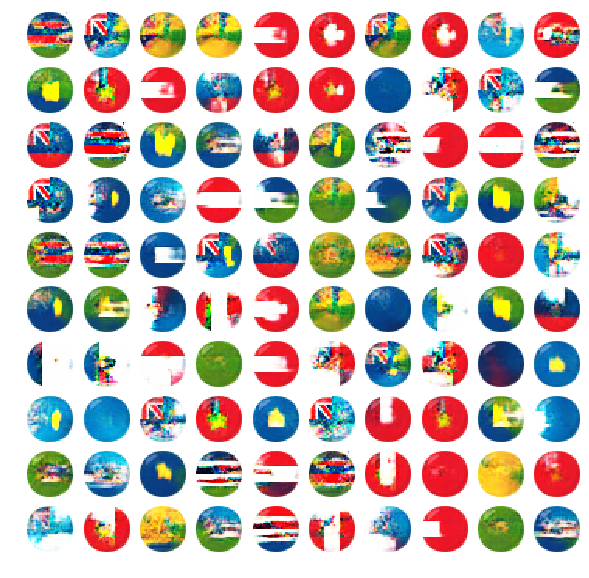

step: 4250, D_loss: 0.130853, D_accuracy: 98.44%, G_loss: 4.125202
step: 4300, D_loss: 0.712248, D_accuracy: 70.31%, G_loss: 6.708215
step: 4350, D_loss: 0.064937, D_accuracy: 99.22%, G_loss: 5.301771
step: 4400, D_loss: 0.088553, D_accuracy: 96.88%, G_loss: 4.557614


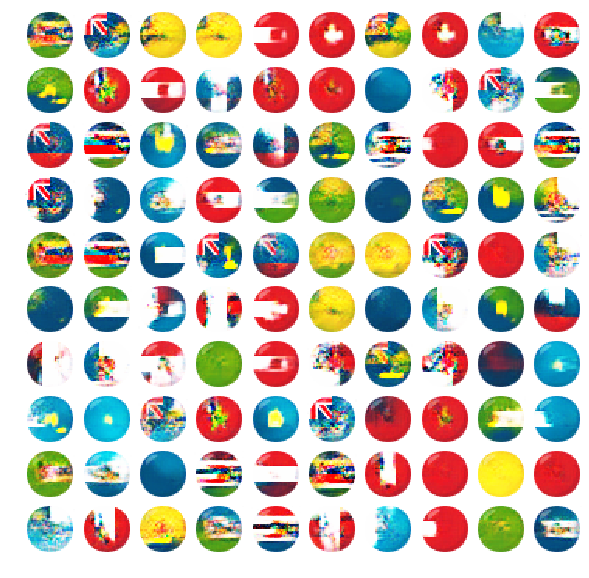

step: 4450, D_loss: 0.063981, D_accuracy: 100.00%, G_loss: 4.949889
step: 4500, D_loss: 0.039379, D_accuracy: 100.00%, G_loss: 4.636612
step: 4550, D_loss: 0.289625, D_accuracy: 86.72%, G_loss: 7.528366
step: 4600, D_loss: 0.075371, D_accuracy: 99.22%, G_loss: 5.032959


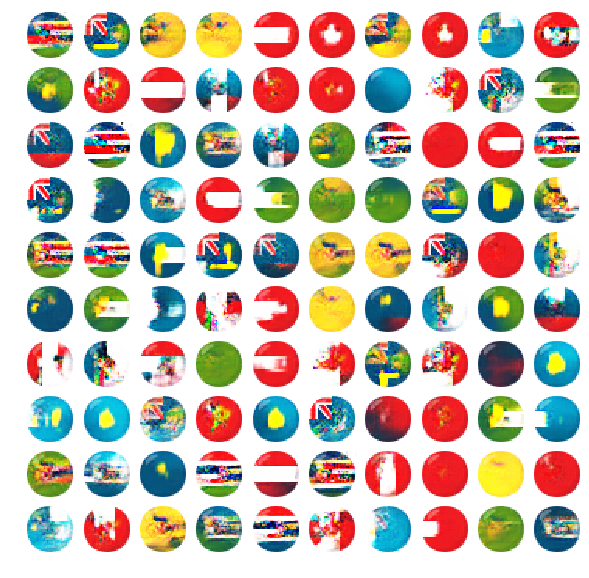

step: 4650, D_loss: 0.256066, D_accuracy: 89.84%, G_loss: 4.158586
step: 4700, D_loss: 0.088240, D_accuracy: 100.00%, G_loss: 4.437259
step: 4750, D_loss: 0.094535, D_accuracy: 100.00%, G_loss: 4.082590
step: 4800, D_loss: 0.291720, D_accuracy: 85.16%, G_loss: 5.873403


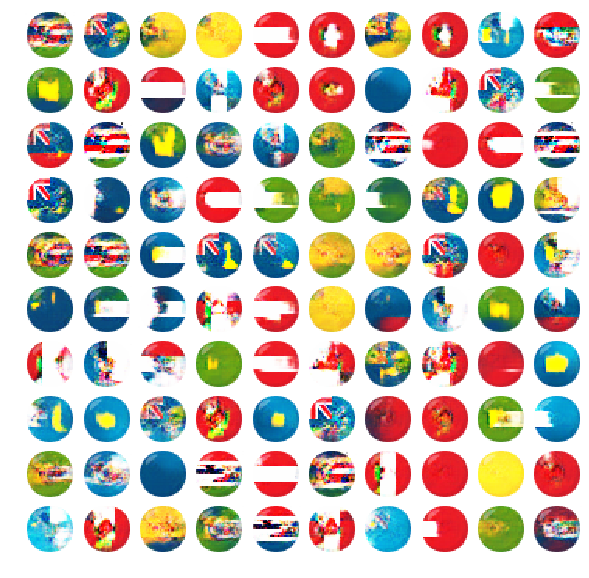

step: 4850, D_loss: 0.059893, D_accuracy: 98.44%, G_loss: 4.401252
step: 4900, D_loss: 0.092584, D_accuracy: 99.22%, G_loss: 3.445654
step: 4950, D_loss: 0.036236, D_accuracy: 100.00%, G_loss: 4.585052
step: 5000, D_loss: 0.067198, D_accuracy: 97.66%, G_loss: 6.929528


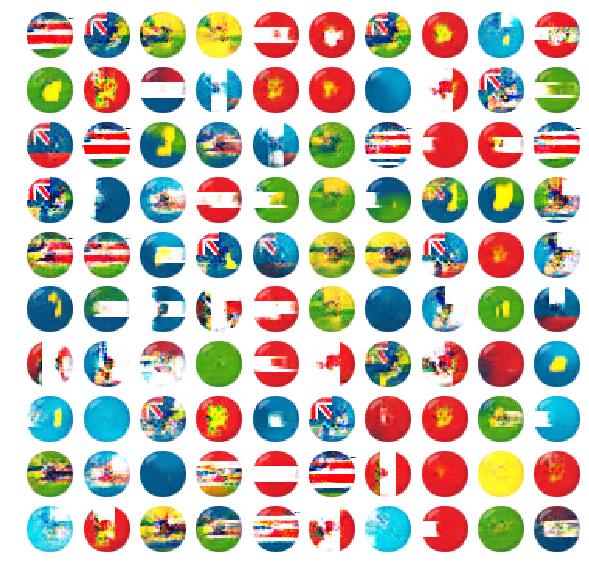

step: 5050, D_loss: 0.081425, D_accuracy: 98.44%, G_loss: 5.819051
step: 5100, D_loss: 0.041926, D_accuracy: 100.00%, G_loss: 5.182031
step: 5150, D_loss: 0.079738, D_accuracy: 98.44%, G_loss: 5.825543
step: 5200, D_loss: 0.046868, D_accuracy: 100.00%, G_loss: 4.300727


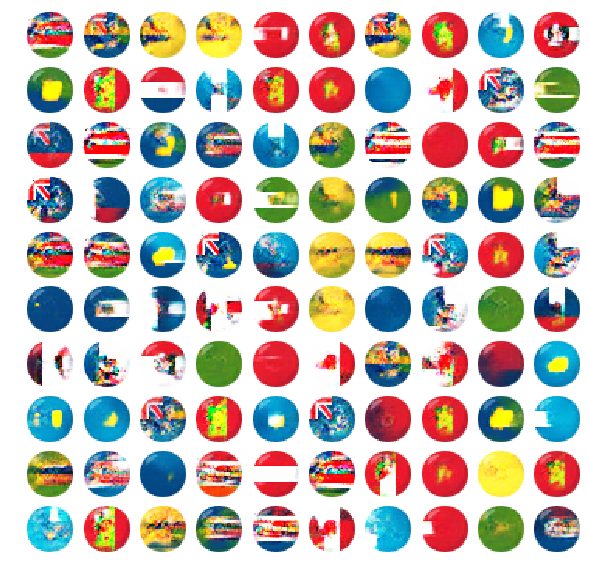

step: 5250, D_loss: 0.806711, D_accuracy: 56.25%, G_loss: 8.979325
step: 5300, D_loss: 0.085336, D_accuracy: 100.00%, G_loss: 4.473431
step: 5350, D_loss: 0.047148, D_accuracy: 100.00%, G_loss: 7.152900
step: 5400, D_loss: 0.071950, D_accuracy: 100.00%, G_loss: 4.206260


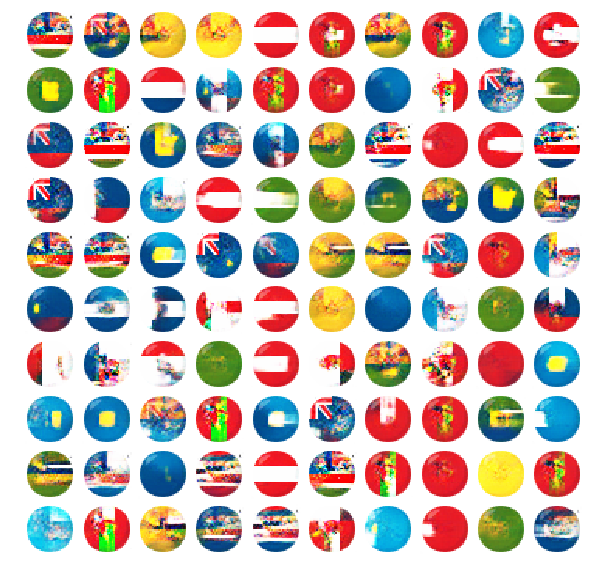

step: 5450, D_loss: 1.835299, D_accuracy: 53.91%, G_loss: 8.550380
step: 5500, D_loss: 0.038015, D_accuracy: 100.00%, G_loss: 5.324019
step: 5550, D_loss: 0.064857, D_accuracy: 100.00%, G_loss: 4.740931
step: 5600, D_loss: 0.140646, D_accuracy: 99.22%, G_loss: 4.537719


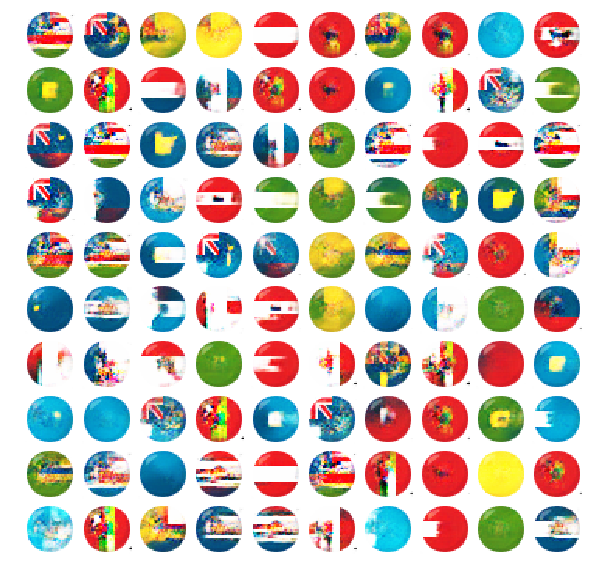

step: 5650, D_loss: 0.027923, D_accuracy: 100.00%, G_loss: 4.572896
step: 5700, D_loss: 0.073525, D_accuracy: 97.66%, G_loss: 7.052820
step: 5750, D_loss: 0.045332, D_accuracy: 100.00%, G_loss: 4.417969
step: 5800, D_loss: 0.054114, D_accuracy: 100.00%, G_loss: 4.908810


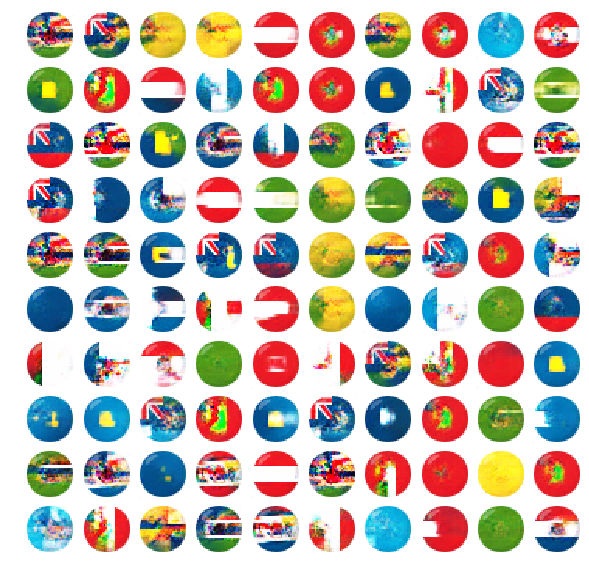

step: 5850, D_loss: 1.032691, D_accuracy: 64.84%, G_loss: 7.708962
step: 5900, D_loss: 0.130398, D_accuracy: 97.66%, G_loss: 4.789903
step: 5950, D_loss: 0.871901, D_accuracy: 64.84%, G_loss: 9.065505
step: 6000, D_loss: 0.043560, D_accuracy: 100.00%, G_loss: 4.785212


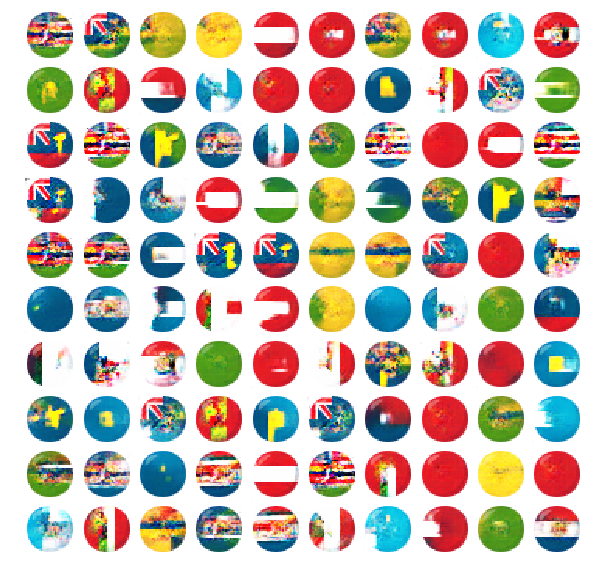

step: 6050, D_loss: 0.593867, D_accuracy: 71.88%, G_loss: 5.959266
step: 6100, D_loss: 0.112358, D_accuracy: 99.22%, G_loss: 4.998022
step: 6150, D_loss: 0.099610, D_accuracy: 99.22%, G_loss: 5.056302
step: 6200, D_loss: 0.032396, D_accuracy: 100.00%, G_loss: 5.143414


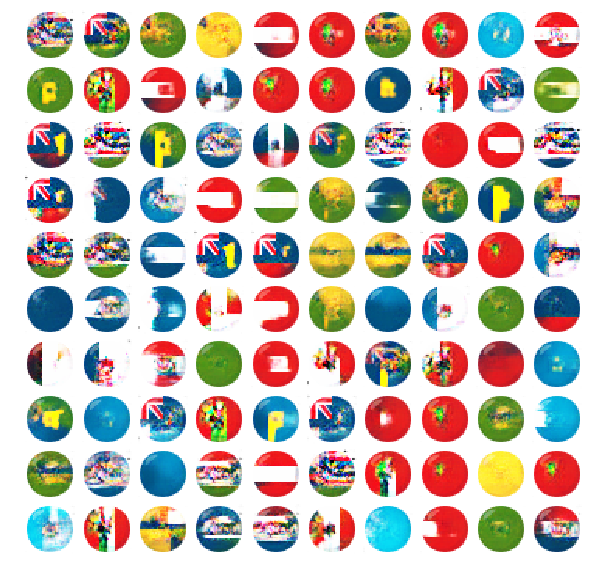

step: 6250, D_loss: 0.075113, D_accuracy: 99.22%, G_loss: 5.048294
step: 6300, D_loss: 0.166880, D_accuracy: 92.97%, G_loss: 3.733505
step: 6350, D_loss: 0.040714, D_accuracy: 100.00%, G_loss: 4.805475
step: 6400, D_loss: 0.027607, D_accuracy: 100.00%, G_loss: 5.199170


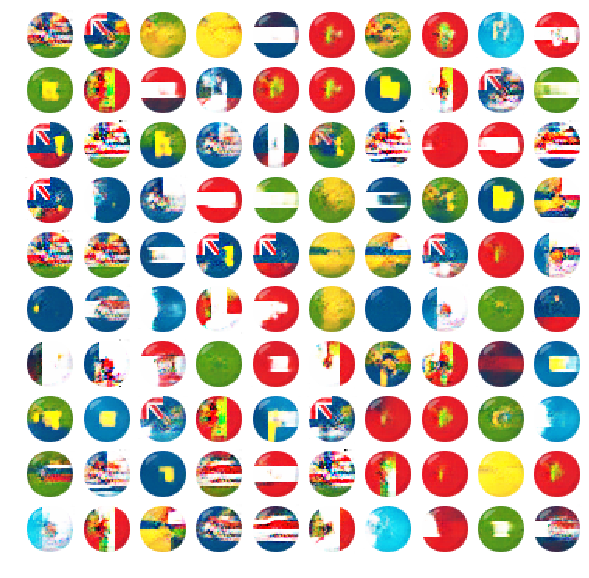

step: 6450, D_loss: 0.056651, D_accuracy: 100.00%, G_loss: 4.467318
step: 6500, D_loss: 0.032140, D_accuracy: 100.00%, G_loss: 5.355968
step: 6550, D_loss: 0.031820, D_accuracy: 100.00%, G_loss: 4.551172
step: 6600, D_loss: 0.157497, D_accuracy: 92.19%, G_loss: 5.186449


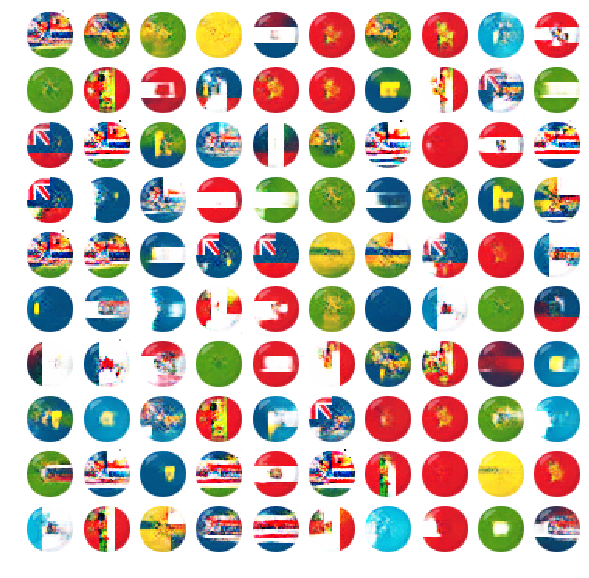

step: 6650, D_loss: 0.964027, D_accuracy: 63.28%, G_loss: 8.564339
step: 6700, D_loss: 0.060827, D_accuracy: 100.00%, G_loss: 5.259835
step: 6750, D_loss: 1.104160, D_accuracy: 68.75%, G_loss: 5.810802
step: 6800, D_loss: 0.375298, D_accuracy: 83.59%, G_loss: 7.135788


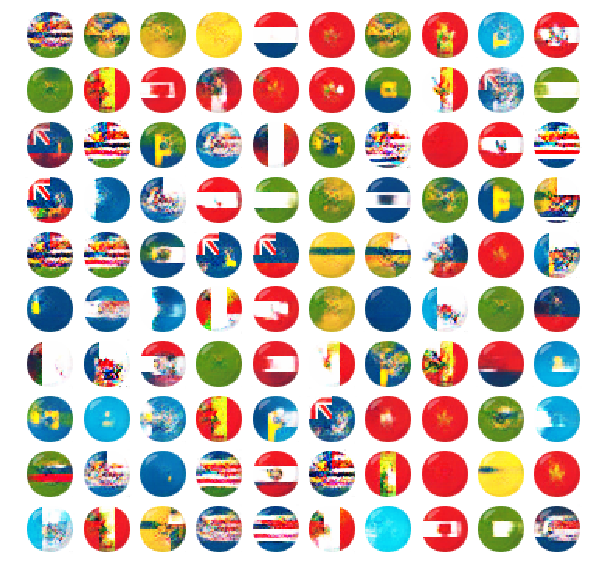

step: 6850, D_loss: 0.046700, D_accuracy: 100.00%, G_loss: 5.166227
step: 6900, D_loss: 0.032478, D_accuracy: 100.00%, G_loss: 5.094624
step: 6950, D_loss: 0.059013, D_accuracy: 99.22%, G_loss: 5.142748
step: 7000, D_loss: 0.058562, D_accuracy: 99.22%, G_loss: 4.816979


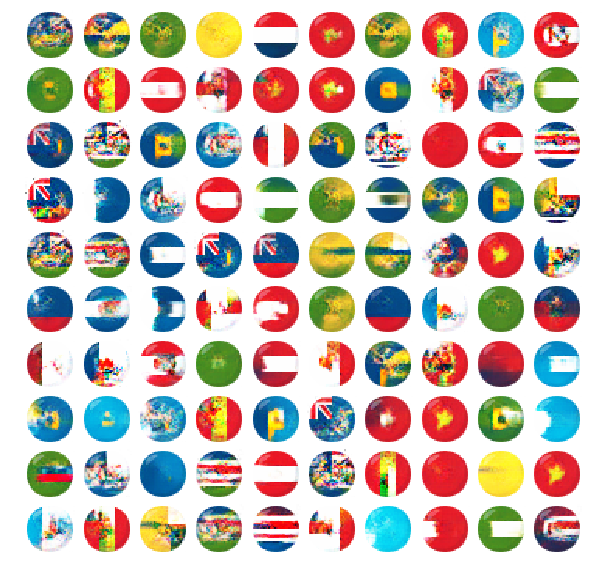

step: 7050, D_loss: 0.016920, D_accuracy: 100.00%, G_loss: 4.896053
step: 7100, D_loss: 0.057021, D_accuracy: 99.22%, G_loss: 5.195476
step: 7150, D_loss: 0.889312, D_accuracy: 66.41%, G_loss: 8.390675
step: 7200, D_loss: 0.064569, D_accuracy: 97.66%, G_loss: 5.603426


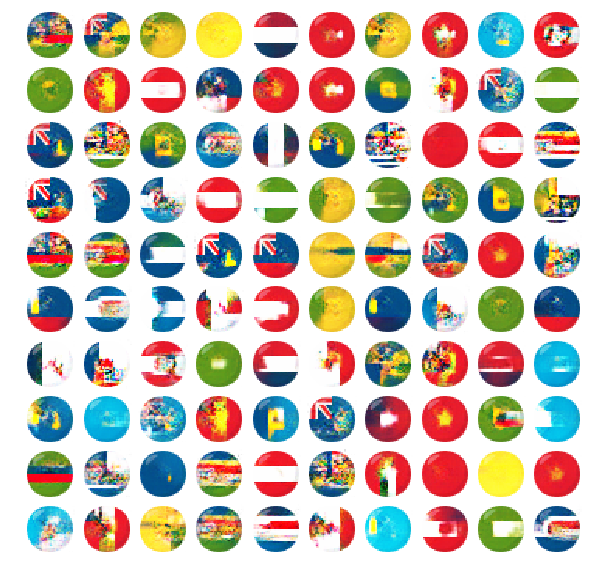

step: 7250, D_loss: 0.024401, D_accuracy: 100.00%, G_loss: 4.862158
step: 7300, D_loss: 0.045646, D_accuracy: 100.00%, G_loss: 5.642845
step: 7350, D_loss: 0.028881, D_accuracy: 100.00%, G_loss: 5.601976
step: 7400, D_loss: 1.402326, D_accuracy: 54.69%, G_loss: 9.477266


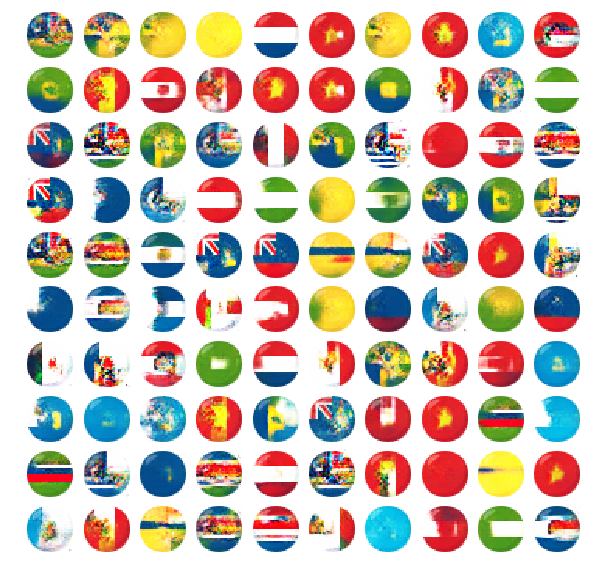

step: 7450, D_loss: 0.059242, D_accuracy: 100.00%, G_loss: 4.959222
step: 7500, D_loss: 0.228869, D_accuracy: 89.06%, G_loss: 5.919586
step: 7550, D_loss: 0.089541, D_accuracy: 99.22%, G_loss: 6.275857
step: 7600, D_loss: 0.019396, D_accuracy: 100.00%, G_loss: 4.325092


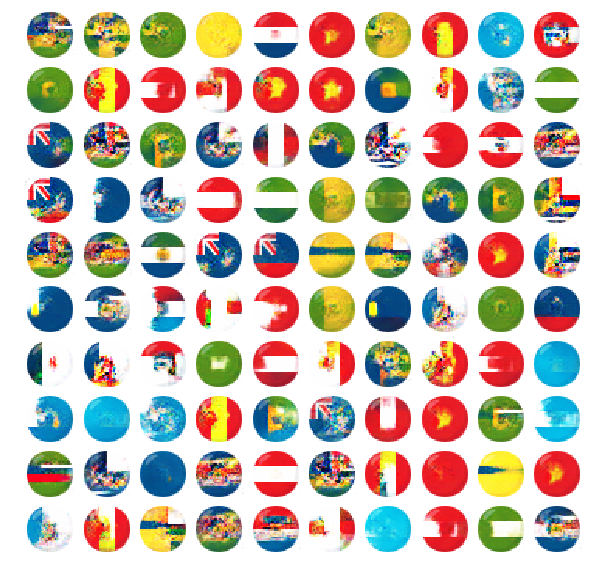

step: 7650, D_loss: 0.047574, D_accuracy: 100.00%, G_loss: 4.841331
step: 7700, D_loss: 0.048492, D_accuracy: 100.00%, G_loss: 5.440073
step: 7750, D_loss: 0.059096, D_accuracy: 98.44%, G_loss: 8.906232
step: 7800, D_loss: 0.067218, D_accuracy: 100.00%, G_loss: 4.287977


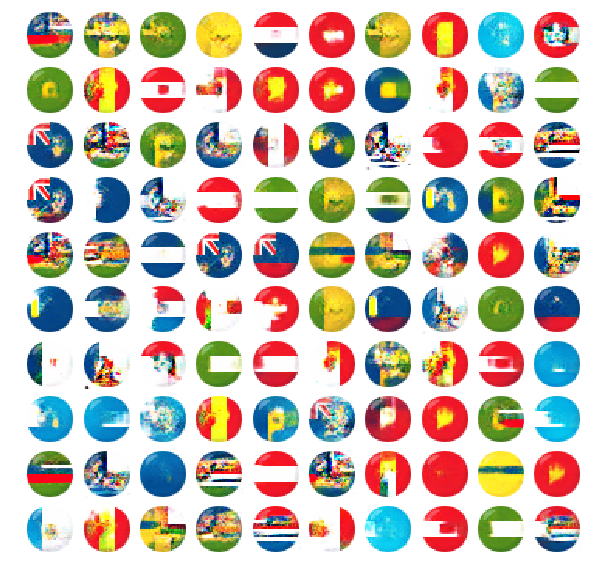

step: 7850, D_loss: 0.145916, D_accuracy: 98.44%, G_loss: 5.521514
step: 7900, D_loss: 0.574462, D_accuracy: 75.00%, G_loss: 9.190250
step: 7950, D_loss: 0.024270, D_accuracy: 100.00%, G_loss: 4.583967
step: 8000, D_loss: 0.059379, D_accuracy: 100.00%, G_loss: 4.677823


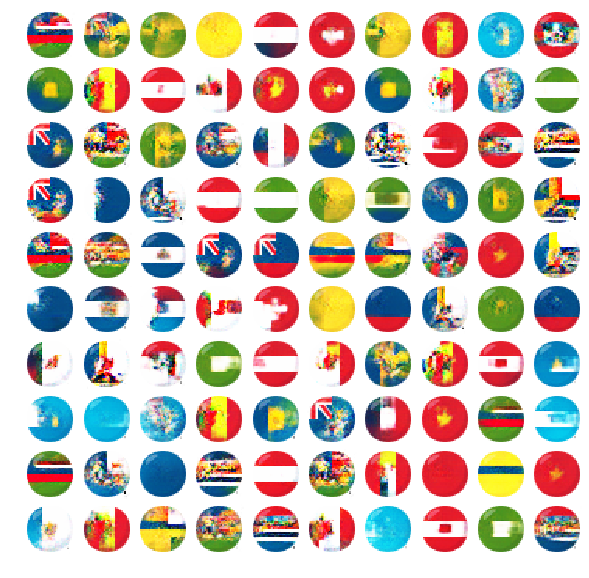

step: 8050, D_loss: 0.045682, D_accuracy: 100.00%, G_loss: 4.831241
step: 8100, D_loss: 0.049337, D_accuracy: 99.22%, G_loss: 5.280370
step: 8150, D_loss: 0.030462, D_accuracy: 100.00%, G_loss: 5.037860
step: 8200, D_loss: 0.078721, D_accuracy: 99.22%, G_loss: 4.890703


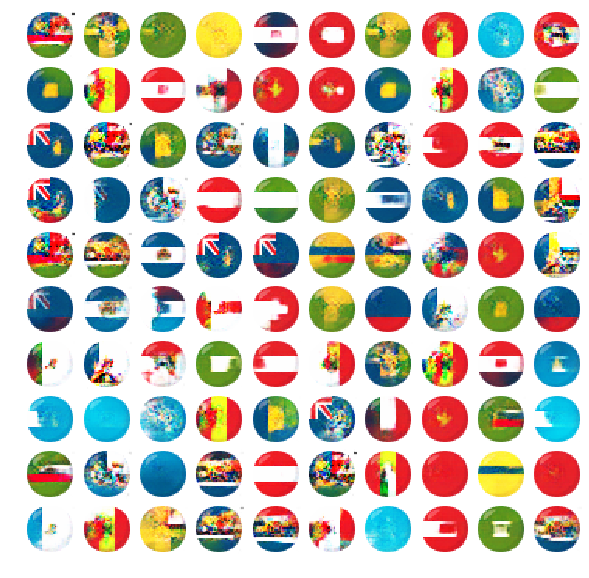

step: 8250, D_loss: 0.035678, D_accuracy: 100.00%, G_loss: 4.493017
step: 8300, D_loss: 0.026974, D_accuracy: 100.00%, G_loss: 5.574062
step: 8350, D_loss: 0.087580, D_accuracy: 99.22%, G_loss: 5.042792
step: 8400, D_loss: 3.082882, D_accuracy: 47.66%, G_loss: 7.815114


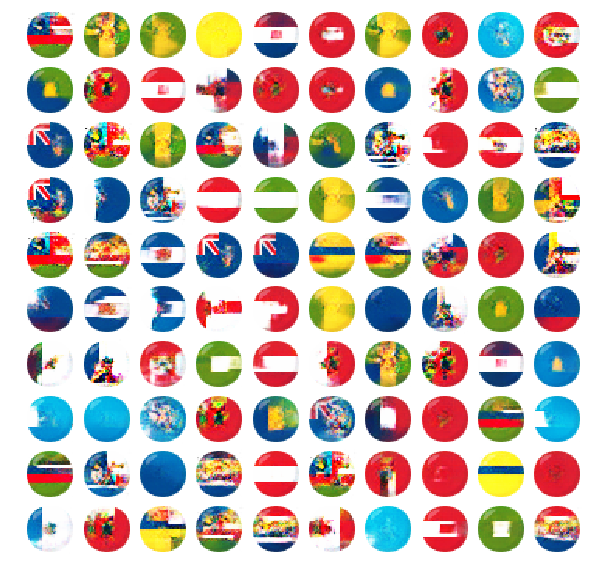

step: 8450, D_loss: 0.034652, D_accuracy: 100.00%, G_loss: 5.267824
step: 8500, D_loss: 0.078096, D_accuracy: 100.00%, G_loss: 4.551125
step: 8550, D_loss: 0.058475, D_accuracy: 100.00%, G_loss: 3.940008
step: 8600, D_loss: 0.025472, D_accuracy: 100.00%, G_loss: 5.754378


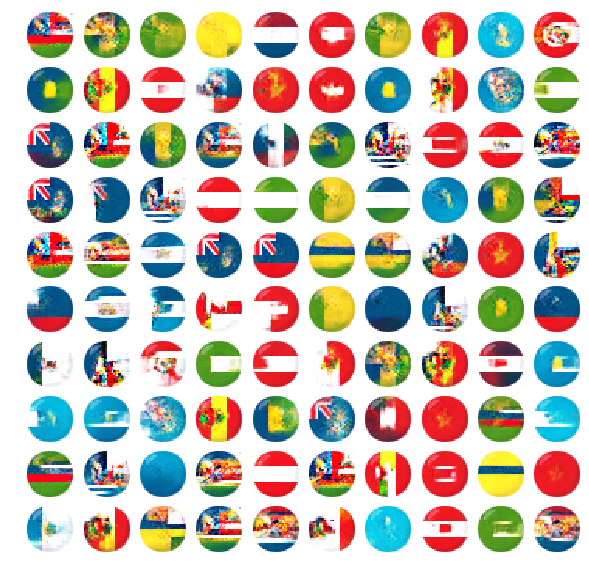

step: 8650, D_loss: 0.079909, D_accuracy: 98.44%, G_loss: 4.681283
step: 8700, D_loss: 0.134584, D_accuracy: 93.75%, G_loss: 5.230160
step: 8750, D_loss: 0.049012, D_accuracy: 99.22%, G_loss: 6.876081
step: 8800, D_loss: 0.038888, D_accuracy: 100.00%, G_loss: 5.063992


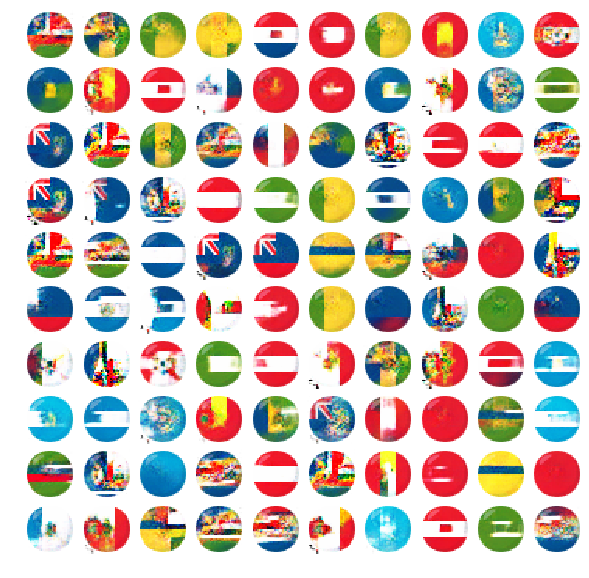

step: 8850, D_loss: 0.043527, D_accuracy: 100.00%, G_loss: 5.442104
step: 8900, D_loss: 0.039423, D_accuracy: 100.00%, G_loss: 5.389678
step: 8950, D_loss: 0.078572, D_accuracy: 97.66%, G_loss: 5.644717
step: 9000, D_loss: 0.073612, D_accuracy: 99.22%, G_loss: 4.841864


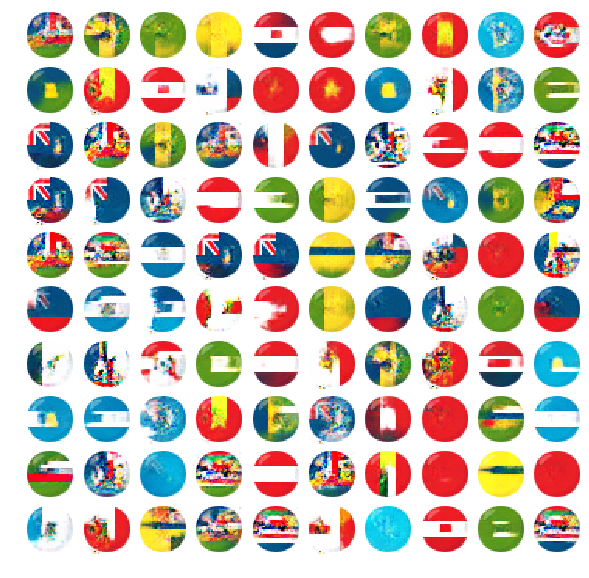

step: 9050, D_loss: 0.041401, D_accuracy: 100.00%, G_loss: 5.836183
step: 9100, D_loss: 0.039739, D_accuracy: 100.00%, G_loss: 5.630916
step: 9150, D_loss: 0.062694, D_accuracy: 98.44%, G_loss: 5.093787
step: 9200, D_loss: 0.057222, D_accuracy: 99.22%, G_loss: 4.796262


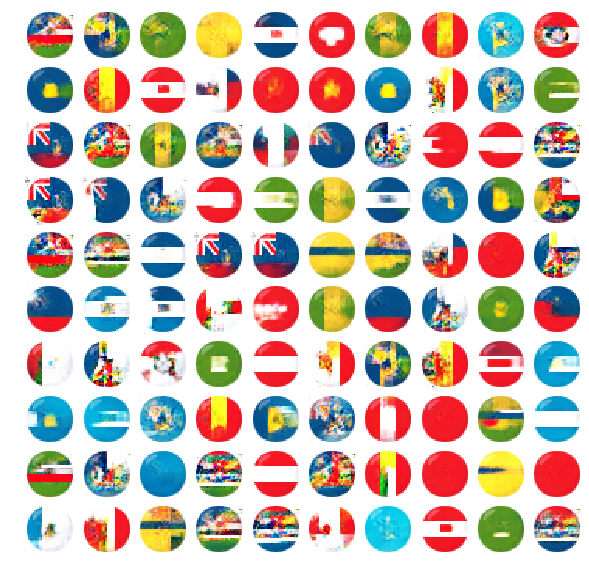

step: 9250, D_loss: 0.092434, D_accuracy: 96.88%, G_loss: 4.405836
step: 9300, D_loss: 0.015460, D_accuracy: 100.00%, G_loss: 5.631783
step: 9350, D_loss: 0.069986, D_accuracy: 97.66%, G_loss: 5.656725
step: 9400, D_loss: 0.064898, D_accuracy: 99.22%, G_loss: 4.880346


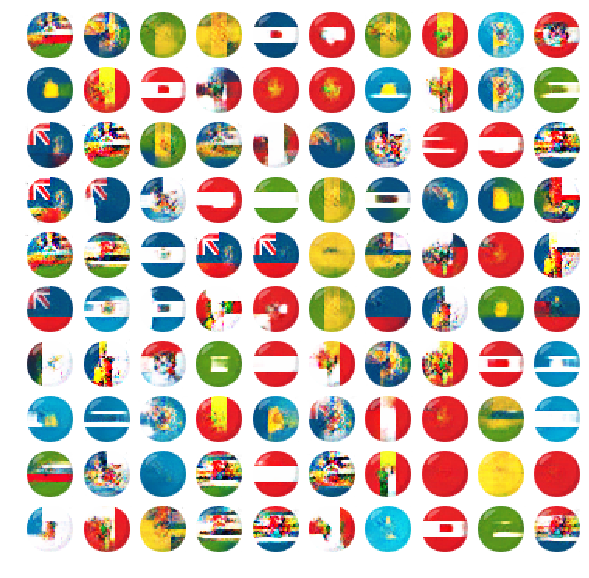

step: 9450, D_loss: 0.033953, D_accuracy: 100.00%, G_loss: 5.559465
step: 9500, D_loss: 0.027204, D_accuracy: 100.00%, G_loss: 5.248494
step: 9550, D_loss: 0.093205, D_accuracy: 97.66%, G_loss: 5.469193
step: 9600, D_loss: 0.025916, D_accuracy: 100.00%, G_loss: 5.729358


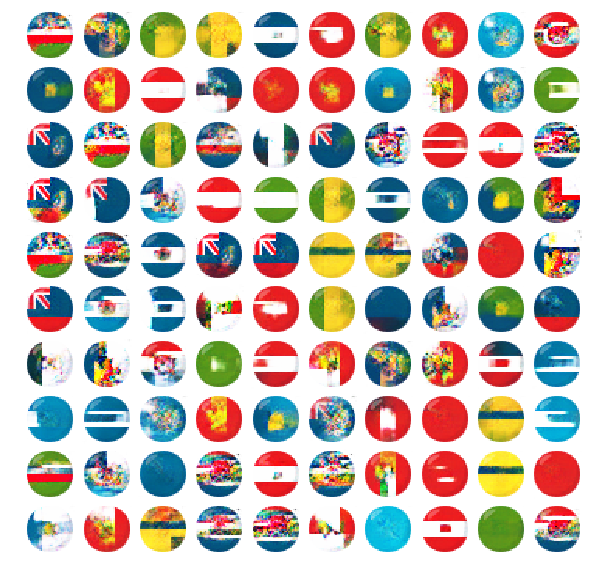

step: 9650, D_loss: 3.321676, D_accuracy: 28.12%, G_loss: 8.429460
step: 9700, D_loss: 0.050238, D_accuracy: 99.22%, G_loss: 4.851644
step: 9750, D_loss: 0.102334, D_accuracy: 97.66%, G_loss: 5.717157
step: 9800, D_loss: 0.025129, D_accuracy: 100.00%, G_loss: 4.957486


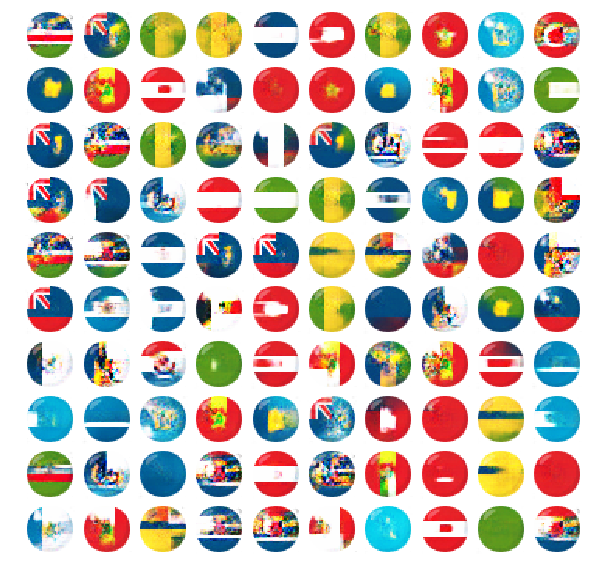

step: 9850, D_loss: 0.039833, D_accuracy: 100.00%, G_loss: 5.361020
step: 9900, D_loss: 0.280362, D_accuracy: 89.06%, G_loss: 6.036789
step: 9950, D_loss: 0.024549, D_accuracy: 100.00%, G_loss: 4.895137
step: 10000, D_loss: 0.039001, D_accuracy: 100.00%, G_loss: 5.296135


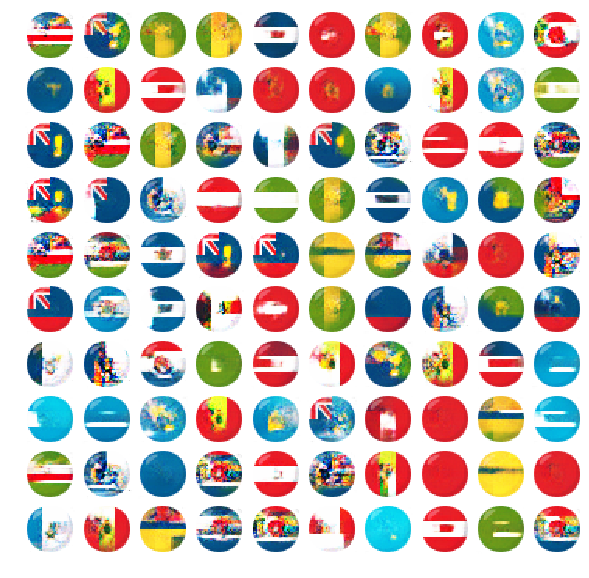

In [14]:
train(compiled_models, noise_size, img_shape, batch_size, steps)

## Plot resutls

In [0]:
%%capture
!pip install import_ipynb
%cd /content
%rm -r /content/0a16ae419d9eba160ddb4f48862fb9e2
!git clone https://gist.github.com/dkatsios/0a16ae419d9eba160ddb4f48862fb9e2.git
%cd /content/0a16ae419d9eba160ddb4f48862fb9e2
import import_ipynb
from IPython.display import HTML
from AnimationDisplay import plot_results
%cd /content

In [0]:
path = '/content/images/{}.png'
iterator = range(200, steps+1, 200)
HTML(plot_results(path, iterator).to_jshtml())

## Download images and generator

In [0]:
gen_path = '/content/gen.h5'
generator.save(gen_path)
from google.colab import files
files.download(gen_path)